In [1]:
# !pip install git+https://github.com/johmedr/dempy.git

In [1]:
from dempy import *

import numpy as np

import plotly.graph_objs as go
import plotly.express as px

import pykeos as pk

/home/jmedrano/prog/python/dempy/dempy/dem.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [104]:
# Prior expectation on the parameters
pE = np.array([
    0.12, # sigma
    0, # r
    -0.6, # b
    0.,
    0.5,
    1.])

def lorenz(x, v, P):
    x0 = P[0] * (x[1] - x[0])
    x1 = P[1] * x[0] - x[2] * x[0] - x[1]
    x2 = x[0] * x[1] - P[2] * x[2]# - 0.25 * (v[0])
    
    return np.array([x0, x1, x2]) / 64
    
def obs(x, v, P): 
    return np.array(x.T @ P[-3:])

models = [GaussianModel(
    fsymb=lorenz, 
    gsymb=obs, 
    n=3, 
    x=np.array([-0.8,3,0])[:, None], # initial state
    pE=pE, sv=1/8., sw=1/8., m=0, 
    W=np.array([[np.exp(32)] * 3]), 
    V=np.array([[np.exp(1)]]), 
)]

hdm = HierarchicalGaussianModel(*models)

Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.02s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


In [105]:
nT = 4096
gen = DEMInversion(hdm, states_embedding_order=3).generate(nT)

plot_dem_generate(hdm, gen, subplots=False); 

# Store "observed" output 
y   = gen.v[:, 0, :1]

pk.SysWrapper(gen.x[:, 0, :]).plot();


  0%|          | 0/4096 [00:00<?, ?it/s]

In [106]:
hdm_dec = hdm.copy()

# hdm_dec[0].x  = np.array([[-0.8,3,0]])
hdm_dec[0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them
hdm_dec[0].W = np.diag([np.exp(0)] * 3)
hdm_dec[0].V = np.diag([np.exp(0)])

deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1, nD=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

In [107]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [108]:
# figs[0][0].write_image('../figures/birdsong_percept_baseline.svg')
figs[0][1].write_image('../figures/birdsong_state_space_baseline.svg')

In [109]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_xz_baseline.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_yz_baseline.svg', height=600, width=800)

fig.show()

In [110]:
fig = pk.SysWrapper(gen.x[:, 0, :]).plot(show=False);
fig = pk.SysWrapper(dec.qU['x'][:, 0]).plot(fig=fig);

In [111]:
fig = go.Figure();
fig.add_scatter(y=gen.v[:, 0, 0], name="Stimulus")
fig.add_scatter(y=dec.qU.x[:, 0, 1]*0.2 + dec.qU.x[:, 0, 2]*1.2, name="Percept")
fig.update_layout(template="plotly_white")
fig.write_image('../figures/birdsong_percept_baseline.svg')
fig

---


In [112]:
hdm_dec = hdm.copy()

hdm_dec[0].x  = np.array([[0.8,-3,0]])
hdm_dec[0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them
hdm_dec[0].W = np.diag([np.exp(0)] * 3)
hdm_dec[0].V = np.diag([np.exp(0)])

deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1, nD=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

In [113]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [116]:
# figs[0][0].write_image('../figures/birdsong_percept_baseline.svg')
figs[0][1].write_image('../figures/birdsong_state_space_baseline.svg')

In [117]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_xz_baseline.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_yz_baseline.svg', height=600, width=800)

fig.show()

In [118]:
fig = go.Figure();
fig.add_scatter(y=gen.v[:, 0, 0], name="Stimulus")
fig.add_scatter(y=dec.qU.x[:, 0, 1]*0.5 + dec.qU.x[:, 0, 2]*1., name="Percept")
fig.update_layout(template="plotly_white")
fig.write_image('../figures/birdsong_percept_baseline.svg')
fig

In [119]:
hdm_dec = hdm.copy()

hdm_dec[0].x  = np.array([[0.8,-3,0]])
hdm_dec[0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them
hdm_dec[0].W = np.diag([np.exp(4)] * 3)
hdm_dec[0].V = np.diag([np.exp(4)])

deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1, nD=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

In [120]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [121]:
# figs[0][0].write_image('../figures/birdsong_percept_baseline.svg')
figs[0][1].write_image('../figures/birdsong_state_space_obtuse_io.svg')

In [122]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_xz_obtuse_io.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_yz_obtuse_io.svg', height=600, width=800)

fig.show()

In [123]:
fig = go.Figure();
fig.add_scatter(y=gen.v[:, 0, 0], name="Stimulus")
fig.add_scatter(y=dec.qU.x[:, 0, 1]*0.5 + dec.qU.x[:, 0, 2]*1., name="Percept")

fig.update_layout(template="plotly_white")
fig.write_image('../figures/birdsong_percept_obtuse_io.svg')
fig

Large precisions, you can synchronise to the stimulus although wrong initial point

In [124]:
hdm_dec = hdm.copy()

hdm_dec[0].x  = np.array([[0.8,-3,0]])
hdm_dec[0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them
hdm_dec[0].W = np.diag([np.exp(32)] * 3)
hdm_dec[0].V = np.diag([np.exp(-2)])

deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

In [125]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [126]:
# figs[0][0].write_image('../figures/birdsong_percept_baseline.svg')
figs[0][1].write_image('../figures/birdsong_state_space_inner_obtuse.svg')

In [127]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_xz_inner_obtuse.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_yz_inner_obtuse.svg', height=600, width=800)

fig.show()

In [128]:
fig = pk.SysWrapper(gen.x[:, 0, :]).plot(show=False);
fig = pk.SysWrapper(dec.qU['x'][:, 0]).plot(fig=fig);

In [131]:
fig = go.Figure();
fig.add_scatter(y=gen.v[:, 0, 0], name="Stimulus")
fig.add_scatter(y=dec.qU.x[:, 0, 1]*0.5 + dec.qU.x[:, 0, 2]*1., name="Percept")

fig.update_layout(template="plotly_white")
fig.write_image('../figures/birdsong_percept_inner_obtuse.svg')
fig

In [144]:
dFdt = (dec.qU.dFdu[:,:-5]).sum(-1)
import scipy.ndimage
LF = dec.qU.LF.squeeze()[5:]
LF = scipy.ndimage.gaussian_filter1d(LF, 5) * 1e-6
LF2 = scipy.ndimage.gaussian_filter1d(LF, 100) 

fig = px.line(y=[LF, LF2])
fig.update_layout(template='plotly_white')

In [133]:
hdm_dec = hdm.copy()

hdm_dec[0].x  = np.array([[0.8,-3,0]])
hdm_dec[0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them
hdm_dec[0].W = np.diag([np.exp(0)] * 3)
hdm_dec[0].V = np.diag([np.exp(4)])

deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

In [134]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [135]:
# figs[0][0].write_image('../figures/birdsong_percept_baseline.svg')
figs[0][1].write_image('../figures/birdsong_state_space_outer_obtuse.svg')

In [136]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_xz_outer_obtuse.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU['x'][:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
fig.write_image('../figures/birdsong_yz_outer_obtuse.svg', height=600, width=800)

fig.show()

In [137]:
fig = pk.SysWrapper(gen.x[:, 0, :]).plot(show=False);
fig = pk.SysWrapper(dec.qU['x'][:, 0]).plot(fig=fig);

In [138]:
fig = go.Figure();
fig.add_scatter(y=gen.v[:, 0, 0], name="Stimulus")
fig.add_scatter(y=dec.qU.x[:, 0, 1]*0.5 + dec.qU.x[:, 0, 2]*1., name="Percept")

fig.update_layout(template="plotly_white")
fig.write_image('../figures/birdsong_percept_outer_obtuse.svg')
fig

In [140]:
dFdt = (dec.qU.dFdu[:,:-5]).sum(-1)
import scipy.ndimage
LF = dec.qU.LF.squeeze()[5:]
LF = scipy.ndimage.gaussian_filter1d(LF, 6) 
LF2 = scipy.ndimage.gaussian_filter1d(LF, 100) 

fig = px.line(y=[dFdt])
fig.update_layout(template='plotly_white')

---
## Learning

In [4]:
print_model_info()


GaussianModel()
# Dynamics
# --------
    f       : Callable  # forward function (must be numpy compatible) 
    g       : Callable  # observation function (must be numpy compatible) 

    fsymb   : Callable  # symbolic declaration of f using sympy
    gsymb   : Callable  # symbolic declaration of g using sympy

    df      : cdotdict
    d2f     : cdotdict
    dg      : cdotdict
    d2g     : cdotdict

# Model dimensions
# ----------------
    m  : int    # number of inputs
    n  : int    # number of states
    l  : int    # number of outputs
    p  : int    # number of parameters

# Parameters 
# ----------
    pE : np.ndarray     # prior expectation of parameters p
    pC : np.ndarray     # prior covariance of parameters p

# Hyperparameters
# ---------------
    hE : np.ndarray         # prior expectation of hyperparameters h (log-precision of cause noise)
    hC : np.ndarray         # prior covariance of hyperparameters h (log-precision of cause noise)

    gE : np.ndarray      

In [42]:
def lorenz(x, v, P):
    x0 = P[0] * (x[1] - x[0])
    x1 = P[1] * x[0] - x[2] * x[0] - x[1]
    x2 = x[0] * x[1] - P[2] * x[2]# - 0.25 * (v[0])
    
    return np.array([x0, x1, x2]) / 32
    
def obs(x, v, P): 
    return np.array(x.T @ P[-3:])

In [43]:
models = [GaussianModel(
    fsymb=lorenz, 
    gsymb=obs, 
    n=3, 
    x=np.array([-0.8,3,0])[:, None], # initial state
    pE=pE, sv=1/8., sw=1/8., m=0, 
    W=np.array([[np.exp(32)] * 3]), 
    V=np.array([[np.exp(1)]]), 
)]

hdm = HierarchicalGaussianModel(*models)

Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


In [44]:
gen = DEMInversion(hdm, states_embedding_order=3).generate(2*nT)

plot_dem_generate(hdm, gen, subplots=False); 

# Store "observed" output 
y   = gen.v[:, 0, :1]

pk.SysWrapper(gen.x[:, 0, :]).plot();


  0%|          | 0/8192 [00:00<?, ?it/s]

In [101]:
from joblib import Parallel, delayed

def invert_model(w, v): 
    print(w, v)
    models = [GaussianModel(
        fsymb=lorenz, 
        gsymb=obs, 
        n=3, 
        x=np.array([-0.8,3,0])[:, None], # initial state
        pE=pE, sv=1/8., sw=1/8., m=0, 
        W=np.array([[np.exp(w)] * 3]), 
        V=np.array([[np.exp(v)]]), 
    )]

    hdm_dec = HierarchicalGaussianModel(*models)

    deminv = DEMInversion(hdm_dec, states_embedding_order=4)
    dec    = deminv.run(y, nE=1)
    
    
    return dec, hdm_dec


# hdms = []

# w = np.linspace(-1,5,7)
v = np.linspace(-1,5,7)
w = np.linspace(6, 10, 5)

for i, wi in enumerate(w):
    hdms.extend(
        [invert_model(wi, vj) for vj in v]
    )
        

6.0 -1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

/home/jmedrano/prog/python/dempy/dempy/dem_dx.py:16: RuntimeWarning:

invalid value encountered in scalar divide



6.0 0.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

6.0 1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6.0 2.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

6.0 3.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

6.0 4.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

6.0 5.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

7.0 -1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7.0 0.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

7.0 1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

7.0 2.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

7.0 3.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7.0 4.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

7.0 5.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 -1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 0.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 2.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 3.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8.0 4.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

8.0 5.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 -1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 0.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9.0 1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 2.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 3.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 4.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

9.0 5.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 -1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 0.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 1.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 2.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



10.0 3.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 4.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.00s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

10.0 5.0
Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


timestep:   0%|          | 0/8192 [00:00<?, ?it/s]

In [99]:
Fs = np.asarray([((_[0].qU.y[1000:, 0] - gen.x[1000:, 0])**2).sum(1).mean(0) for _ in hdms]).reshape(12,7)
print(Fs)
import scipy.ndimage

from matplotlib import pyplot as plt
Fs = scipy.ndimage.zoom(np.log(Fs[1:]), 3)

plt.contourf(Fs)
plt.colorbar()

array([5., 6., 7., 8., 9.])

[[7.89825277e+17 6.30244854e+17            nan            nan
             nan            nan            nan]
 [2.39693993e-01 3.31791797e-01 4.29382015e-01 9.45978188e-01
  5.55806471e+01 7.46493603e+01 9.11761366e+01]
 [1.95384907e-01 2.75564612e-01 3.72577613e-01 4.52369759e+01
  7.47120148e+01 9.04442497e+01 8.45409138e+01]
 [1.52499723e-01 2.24773443e-01 3.10118058e-01 4.80817709e+01
  9.15483758e+01 8.47123901e+01 6.60524280e+01]
 [1.37684514e-01 2.08238078e-01 2.88731492e-01 1.03235314e+00
  9.17716536e+01 7.99887283e+01 4.84052075e+01]
 [1.35175075e-01 2.05001702e-01 2.81601302e-01 1.03973635e+00
  9.16568143e+01 7.76840900e+01 4.01465756e+01]
 [1.34860526e-01 2.04354537e-01 2.78968334e-01 1.03208708e+00
  9.16059192e+01 7.67723906e+01 3.71070628e+01]
 [1.34888080e-01 2.04243895e-01 2.78243066e-01 1.02399649e+00
  9.15975099e+01 7.64375139e+01 3.60260701e+01]
 [1.34943478e-01 2.04254418e-01 2.78221275e-01 1.02353737e+00
  9.15997015e+01 7.63180996e+01 3.56440439e+01]
 [1.349692

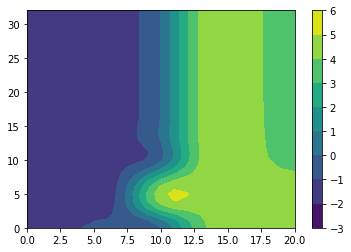

In [103]:
Fs = np.asarray([((_[0].qU.x[1000:, 0] - gen.x[1000:, 0])**2).sum(1).mean(0) for _ in hdms]).reshape(12,7)
print(Fs)
import scipy.ndimage

from matplotlib import pyplot as plt
Fs = scipy.ndimage.zoom(np.log(Fs[1:]), 3)

plt.contourf(Fs)
plt.colorbar()

In [295]:
models = [GaussianModel(
    fsymb=lorenz, 
    gsymb=obs, 
    n=3, 
    x=np.array([0.8,-3,0])[:, None], # initial state
    pE=pE, sv=1/8., sw=1/8., m=1, 
    Q  = [np.eye(1)],
    R  = [np.eye(3)],
#     hE = [3], hC=[np.exp(4)],
    V=np.array([[np.exp(4)]]), 
    gE = [0], gC=[np.exp(-2)],
)]

hdm_dec = HierarchicalGaussianModel(*models)

Compiling derivatives, it might take some time... 
  Compiling f... f() ok. (compiled in 0.01s)
  Compiling g... g() ok. (compiled in 0.01s)
Done. 


In [304]:
hdm_dec[1].V *= np.exp(-4)

In [305]:


deminv = DEMInversion(hdm_dec, states_embedding_order=4)
dec    = deminv.run(y, nE=1, nM=1)

timestep:   0%|          | 0/4096 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [306]:
fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(dec.qU.x[:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
# fig.write_image('../figures/birdsong_xz_outer_obtuse.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(dec.qU.x[:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
# fig.write_image('../figures/birdsong_yz_outer_obtuse.svg', height=600, width=800)

fig.show()

In [307]:
figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);

In [266]:
Nb = 16
Nw = gen.v.shape[0] // Nb
print(Nw)
hdms_dec = []
decs = []
from tqdm.autonotebook import tqdm
for i in tqdm(range(Nb)):
    y = gen.v[Nw*i:Nw*(i+1), 0, :1]

    # Copy model
    hdms_dec.append(hdm_dec.copy())
    
    # Update precision
    if i > 0: 
        
#         hdms_dec[i][0].hE = dec.qH.h[0,0,None,None]
#         hdms_dec[i][0].hC = np.abs(dec.qH.C[0,0,None,None])
#         hdms_dec[i][0].gC = dec.qH.h[0,0,None,None]

#         hdms_dec[i][0].hC = np.exp(4)
        hdms_dec[i][0].gE = dec.qH.h[0,0,None,None]
#         hdms_dec[i][0].gC = np.abs(dec.qH.C[0,0,None,None])
        
        
#         hdms_dec[i][0].gC = np.exp(4)
        hdms_dec[i][0].x       = dec.qU.x[-1, 0, :]
        hdms_dec[i][0].pC = np.diag(np.ones(pE.shape)) * np.exp(-128) # give high precision to the parameters to avoid changing them

    
    deminv = DEMInversion(hdms_dec[i], states_embedding_order=4)
    dec    = deminv.run(y, nE=8, nM=8)
    
#     print(dec.F)
    decs.append(dec)

256


  0%|          | 0/16 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

E-step (F = -inf):   0%|          | 0/8 [00:00<?, ?it/s]

  M-step:   0%|          | 0/8 [00:00<?, ?it/s]

timestep:   0%|          | 0/256 [00:00<?, ?it/s]

In [267]:
qH = np.asarray([_.qH.h.squeeze() for _ in decs])
px.line(y=[qH[:,0]])

In [268]:
import scipy.ndimage
px.line(y=scipy.ndimage.gaussian_filter1d(np.asarray([_.F.squeeze() for _ in decs]), 0.001))

ValueError: could not convert string to float: 'wide_variable_0'

In [269]:
qUx = np.concatenate([_.qU.x for _ in decs], 0)
qUy = np.concatenate([_.qU.y for _ in decs], 0)


fig = pk.SysWrapper(gen.x[:, 0, [0,2]]).plot(show=False)
pk.SysWrapper(qUx[:, 0, [0,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-2.5,2.5))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
# fig.write_image('../figures/birdsong_xz_outer_obtuse.svg', height=600, width=800)
fig.show()

fig = pk.SysWrapper(gen.x[:, 0, [1,2]]).plot(show=False)
pk.SysWrapper(qUx[:, 0, [1,2]]).plot(fig=fig, show=False)
fig.update_layout(template='plotly_white')
fig.update_xaxes(showline=True, linewidth=1,linecolor='black', mirror=True, range=(-14,14))
fig.update_yaxes(showline=True,linecolor='black', mirror=True, linewidth=1, range=(-15,10))
# fig.write_image('../figures/birdsong_yz_outer_obtuse.svg', height=600, width=800)

fig.show()

In [270]:
dec = decs[-1]
dec.qU.x = qUx
dec.qU.y = qUy

figs = plot_dem_states(hdm, dec, gen, names={'y[0,0]': 'y+z', 'x[0,0]': 'x', 'x[0,1]': 'y', 'x[0,2]': 'z'}, subplots=False, show_ci=False);